In [339]:
import pandas as pd
import os
import glob
import re
import matplotlib.pyplot as plt

In [340]:
#!pip install cufflink
#!pip install plotly

In [341]:
import numpy as np
import seaborn as sns

#import cufflinks as cf

import plotly.graph_objects as go
from plotly.subplots import make_subplots

from plotly.offline import init_notebook_mode, download_plotlyjs,plot,iplot
import plotly.express as px

%matplotlib inline
#cf.go_offline()

init_notebook_mode(connected=True)

### importing 2015/16 data for analyzing leicester's league victory  

In [343]:
pl16 = pd.read_csv('pl_15-16.csv')
#pl17 = pd.read_csv('pl_16-17.csv')
#pl18 = pd.read_csv('pl_17-18.csv')
#pl19 = pd.read_csv('pl_18-19.csv')
#pl20 = pd.read_csv('pl_19-20.csv')

In [344]:
pl16.drop("Unnamed: 0", axis=1, inplace=True)

In [345]:
pl16.describe().iloc[:,30:]

,Goals with right foot,Goals with left foot,Hit woodwork,Goals per match,Penalties scored,Freekicks scored,Shots,Shots on target,Big chances missed,Saves,Penalties saved,Punches,High Claims,Catches,Sweeper clearances,Throw outs,Goal Kicks
count,681.000000,681.000000,681.000000,435.000000,435.000000,435.000000,435.000000,435.000000,435.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000
mean,0.757709,0.358297,0.328928,0.072115,0.156322,0.048276,18.000000,6.137931,1.427586,28.618421,0.144737,6.000000,13.000000,3.526316,7.355263,40.144737,82.842105
std,2.020855,1.080969,0.864598,0.121436,0.650009,0.253938,25.590087,9.899230,2.902593,36.768453,0.508696,10.919096,18.285149,5.095027,11.260200,57.951406,108.159765
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,1.000000,0.000000,7.000000,0.000000,0.000000,1.500000,0.000000,1.500000,7.000000,19.500000
75%,0.000000,0.000000,0.000000,0.110000,0.000000,0.000000,28.500000,9.000000,1.000000,60.500000,0.000000,8.250000,22.250000,6.250000,10.500000,60.500000,156.000000
max,19.000000,13.000000,7.000000,0.800000,6.000000,2.000000,158.000000,75.000000,22.000000,121.000000,3.000000,66.000000,81.000000,18.000000,46.000000,204.000000,378.000000


In [347]:
#pl01 = pd.read_csv('pl_2000-2001.csv')

In [348]:
pl_full_data = pd.read_csv("English_Premier_League_data_2009-2019.csv")

In [349]:
pl_data = pl_full_data.copy()

## Match data statistics

In [353]:
pl_full_data

,Div,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,...,HST,AST,HF,AF,HC,AC,HY,AY,HR,AR
0,E0,2009-08-15 00:00:00,Aston Villa,Wigan,0,2,A,0,1,A,...,5,7,15,14,4,6,2,2,0,0
1,E0,2009-08-15 00:00:00,Blackburn,Man City,0,2,A,0,1,A,...,9,5,12,9,5,4,2,1,0,0
2,E0,2009-08-15 00:00:00,Bolton,Sunderland,0,1,A,0,1,A,...,3,13,16,10,4,7,2,1,0,0
3,E0,2009-08-15 00:00:00,Chelsea,Hull,2,1,H,1,1,D,...,12,3,13,15,12,4,1,2,0,0
4,E0,2009-08-15 00:00:00,Everton,Arsenal,1,6,A,0,3,A,...,5,9,11,13,4,9,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3795,E0,2019-05-12 00:00:00,Liverpool,Wolves,2,0,H,1,0,H,...,5,2,3,11,4,1,0,2,0,0
3796,E0,2019-05-12 00:00:00,Man United,Cardiff,0,2,A,0,1,A,...,10,4,9,6,11,2,3,3,0,0
3797,E0,2019-05-12 00:00:00,Southampton,Huddersfield,1,1,D,1,0,H,...,3,3,8,6,4,3,0,1,0,0
3798,E0,2019-05-12 00:00:00,Tottenham,Everton,2,2,D,1,0,H,...,3,9,10,13,7,4,0,2,0,0


In [355]:
pl_full_data.columns

Index(['Div', 'Date', 'HomeTeam', 'AwayTeam', 'FTHG', 'FTAG', 'FTR', 'HTHG',
       'HTAG', 'HTR', 'Referee', 'HS', 'AS', 'HST', 'AST', 'HF', 'AF', 'HC',
       'AC', 'HY', 'AY', 'HR', 'AR'],
      dtype='object')

In [356]:
#dropping first column 'Div' as value is always E0
pl_data = pl_data.drop(['Div'], axis=1)

In [357]:
pl_data.columns=['Date','HomeTeam','AwayTeam','FT_Home_Goal','FT_Away_Goal','FT_Result','HT_Home_Goal','HT_Away_Goal',
                        'HT_Result','Referee','H_Shots','A_Shots','H_Shots_Target','A_Shots_Target','H_Foul',
                        'A_Foul','H_Corner','A_Corner','H_Yellow','A_Yellow','H_Red','A_Red']

In [358]:
pl_data.head()

,Date,HomeTeam,AwayTeam,FT_Home_Goal,FT_Away_Goal,FT_Result,HT_Home_Goal,HT_Away_Goal,HT_Result,Referee,...,H_Shots_Target,A_Shots_Target,H_Foul,A_Foul,H_Corner,A_Corner,H_Yellow,A_Yellow,H_Red,A_Red
0,2009-08-15 00:00:00,Aston Villa,Wigan,0,2,A,0,1,A,M Clattenburg,...,5,7,15,14,4,6,2,2,0,0
1,2009-08-15 00:00:00,Blackburn,Man City,0,2,A,0,1,A,M Dean,...,9,5,12,9,5,4,2,1,0,0
2,2009-08-15 00:00:00,Bolton,Sunderland,0,1,A,0,1,A,A Marriner,...,3,13,16,10,4,7,2,1,0,0
3,2009-08-15 00:00:00,Chelsea,Hull,2,1,H,1,1,D,A Wiley,...,12,3,13,15,12,4,1,2,0,0
4,2009-08-15 00:00:00,Everton,Arsenal,1,6,A,0,3,A,M Halsey,...,5,9,11,13,4,9,0,0,0,0


In [359]:
labels = ['Home Team Wins','Away Team Wins','Draw']
ft_results = pd.DataFrame(pl_data['FT_Result'].value_counts())
ft_results.head()



,FT_Result
H,1758
A,1102
D,940


In [360]:
values = ft_results["FT_Result"].values
values

array([1758, 1102,  940], dtype=int64)

## home team- away team record

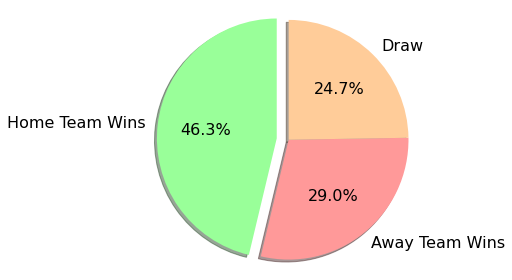

In [116]:

# Pie chart
colors = ['#99ff99','#ff9999','#ffcc99']
sizes = [30, 45, 10]
# only "explode" the 2nd slice (i.e. 'Hogs')
explode = (0.1, 0, 0)  
fig1, ax1 = plt.subplots()

ax1.pie(values, explode=explode, labels=labels, autopct='%2.1f%%',colors= colors,
        shadow=True, startangle=90,textprops={'fontsize': 16})
# Equal aspect ratio ensures that pie is drawn as a circle
ax1.axis('equal')  
plt.tight_layout()
plt.show()


### preparing data for BAR CHART RACE and importing necessary files

In [361]:
import sys
!{sys.executable} -m pip install bar_chart_race

In [362]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

import bar_chart_race as bcr
from IPython.display import HTML
import warnings
warnings.filterwarnings("ignore")
from IPython.display import Video

In [363]:
pgfgg = pd.read_csv('all_season/Premier League 00_01.csv')

In [364]:
pgfgg.head()

,Position,Club,Played,Won,Drawn,Lost,GF,GA,GD,Points,season
0,1,Manchester United,38,24,8,6,79,31,48,80,2000/2001
1,2,Arsenal,38,20,10,8,63,38,25,70,2000/2001
2,3,Liverpool,38,20,9,9,71,39,32,69,2000/2001
3,4,Leeds United,38,20,8,10,64,43,21,68,2000/2001
4,5,Ipswich Town,38,20,6,12,57,42,15,66,2000/2001


In [365]:
dir_loc='all_season/'

In [366]:
year=[]
loc=[]
for file in os.listdir(dir_loc):
    print(file)
    
    if file[-6]=='9':
        year+=[1900+int(file[-6:-4])]
        loc+=[os.path.join(dir_loc,file)]
    else:
        year+=[2000+int(file[-6:-4])]
        loc+=[os.path.join(dir_loc,file)]

Premier League 00_01.csv
Premier League 01_02.csv
Premier League 02_03.csv
Premier League 03_04.csv
Premier League 04_05.csv
Premier League 05_06.csv
Premier League 06_07.csv
Premier League 07_08.csv
Premier League 08_09.csv
Premier League 09_10.csv
Premier League 10_11.csv
Premier League 11_12.csv
Premier League 12_13.csv
Premier League 13_14.csv
Premier League 14_15.csv
Premier League 15_16.csv
Premier League 16_17.csv
Premier League 17_18.csv
Premier League 18_19.csv
Premier League 19_20.csv
Premier League 92_93.csv
Premier League 93_94.csv
Premier League 94_95.csv
Premier League 95_96.csv
Premier League 96_97.csv
Premier League 97_98.csv
Premier League 98_99.csv
Premier League 99_00.csv


In [367]:
df_season = pd.DataFrame(loc,year)
df_season = df_season.sort_index()
df_season.reset_index(inplace=True)
df_season.rename(columns = {0:'loc','index':'year'}, inplace = True)

In [368]:
df_season

,year,loc
0,1993,all_season/Premier League 92_93.csv
1,1994,all_season/Premier League 93_94.csv
2,1995,all_season/Premier League 94_95.csv
3,1996,all_season/Premier League 95_96.csv
4,1997,all_season/Premier League 96_97.csv
5,1998,all_season/Premier League 97_98.csv
6,1999,all_season/Premier League 98_99.csv
7,2000,all_season/Premier League 99_00.csv
8,2001,all_season/Premier League 00_01.csv
9,2002,all_season/Premier League 01_02.csv


In [369]:
data=pd.read_csv(df_season.loc[0,'loc'])
data.columns

Index(['Position', 'Club', 'Played', 'Won', 'Drawn', 'Lost', 'GF', 'GA', 'GD',
       'Points', 'season'],
      dtype='object')

In [370]:
final_data=data[['Position','Club','season','Points']]
final_data.loc[:,'year']=1993


for j in range(1,len(df_season)):
    if j==14:
        df_add =pd.read_csv(df_season.loc[j,'loc'])
        df_add.rename(columns={'PointsForm':'Points',}, inplace=True)
        df_add.loc[:,'year']=(1993+j)
        conc=df_add[['Position','Club','season','Points','year']]
        final_data=pd.concat([final_data,conc])        
    
    elif j!=14:
        df_add =pd.read_csv(df_season.loc[j,'loc'])
        df_add.loc[:,'year']=(1993+j)
        conc=df_add[['Position','Club','season','Points','year']]
        final_data=pd.concat([final_data,conc])

final_data

,Position,Club,season,Points,year
0,1,Manchester United,1992/1993,84.0,1993
1,2,Aston Villa,1992/1993,74.0,1993
2,3,Norwich City,1992/1993,72.0,1993
3,4,Blackburn Rovers,1992/1993,71.0,1993
4,5,Queens Park Rangers,1992/1993,63.0,1993
...,...,...,...,...,...
15,16,West Ham United,2019/2020,27.0,2020
16,17,Watford,2019/2020,27.0,2020
17,18,Bournemouth,2019/2020,27.0,2020
18,19,Aston Villa,2019/2020,25.0,2020


In [371]:
final_data.describe()

,Position,Points,year
count,566.000000,566.000000,566.000000
mean,10.616608,52.210247,2006.367491
std,5.850619,16.272567,8.143792
min,1.000000,11.000000,1993.000000
25%,6.000000,41.000000,1999.000000
50%,11.000000,49.000000,2006.000000
75%,16.000000,62.750000,2013.000000
max,22.000000,100.000000,2020.000000


In [372]:
final_stats_data=data[["Club","Played","Won","Drawn","Lost","GF","GA","GD","Points","season"]]


final_stats_data.loc[:,'year']=1993


for j in range(1,len(df_season)):
    if j==14:
        df_add =pd.read_csv(df_season.loc[j,'loc'])
        df_add.rename(columns={'PointsForm':'Points',}, inplace=True)
        df_add.rename(columns={'\tPlayed':'Played'}, inplace=True)
        df_add.loc[:,'year']=(1993+j)
        conc=df_add[["Club","Played","Won","Drawn","Lost","GF","GA","GD","Points","season","year"]]
        final_stats_data=pd.concat([final_stats_data,conc])        
    
    elif j!=14:
        df_add =pd.read_csv(df_season.loc[j,'loc'])
        df_add.loc[:,'year']=(1993+j)
        df_add.rename(columns={'\tPlayed':'Played'}, inplace=True)
        conc=df_add[["Club","Played","Won","Drawn","Lost","GF","GA","GD","Points","season","year"]]
        final_stats_data=pd.concat([final_stats_data,conc])

final_stats_data

,Club,Played,Won,Drawn,Lost,GF,GA,GD,Points,season,year
0,Manchester United,42,24,12,6,67,31,36,84.0,1992/1993,1993
1,Aston Villa,42,21,11,10,57,40,17,74.0,1992/1993,1993
2,Norwich City,42,21,9,12,61,65,-4,72.0,1992/1993,1993
3,Blackburn Rovers,42,20,11,11,68,46,22,71.0,1992/1993,1993
4,Queens Park Rangers,42,17,12,13,63,55,8,63.0,1992/1993,1993
...,...,...,...,...,...,...,...,...,...,...,...
15,West Ham United,29,7,6,16,35,50,-15,27.0,2019/2020,2020
16,Watford,29,6,9,14,27,44,-17,27.0,2019/2020,2020
17,Bournemouth,29,7,6,16,29,47,-18,27.0,2019/2020,2020
18,Aston Villa,28,7,4,17,34,56,-22,25.0,2019/2020,2020


In [373]:
file_name = 'prem_scoreboard.xlsx'
  
# saving the excel
final_stats_data.to_excel(file_name)

### data for bar chart point race

In [374]:
final1 = final_data.copy()
final2 = final1.set_index(['season','Club'])
final3 = final1.set_index(['season','Club']).unstack()['Points']
final3.fillna(0,inplace = True)

In [375]:
final3

Club,Arsenal,Aston Villa,Barnsley,Birmingham City,Blackburn Rovers,Blackpool,Bolton Wanderers,Bournemouth,Bradford City,Brighton and Hove Albion,...,Swansea City,Swindon Town,Tottenham Hotspur,Watford,West Bromwich Albion,West Ham United,WestHam United,Wigan Athletic,Wimbledon,Wolverhampton Wanderers
season,,,,,,,,,,,,,,,,,,,,,
1992/1993,56.0,74.0,0.0,0.0,71.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,59.0,0.0,0.0,0.0,0.0,0.0,54.0,0.0
1993/1994,71.0,57.0,0.0,0.0,84.0,0.0,0.0,0.0,0.0,0.0,...,0.0,30.0,45.0,0.0,0.0,52.0,0.0,0.0,65.0,0.0
1994/1995,51.0,48.0,0.0,0.0,89.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,62.0,0.0,0.0,50.0,0.0,0.0,56.0,0.0
1995/1996,63.0,63.0,0.0,0.0,61.0,0.0,29.0,0.0,0.0,0.0,...,0.0,0.0,61.0,0.0,0.0,51.0,0.0,0.0,41.0,0.0
1996/1997,68.0,61.0,0.0,0.0,42.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,46.0,0.0,0.0,42.0,0.0,0.0,56.0,0.0
1997/1998,78.0,57.0,35.0,0.0,58.0,0.0,40.0,0.0,0.0,0.0,...,0.0,0.0,44.0,0.0,0.0,56.0,0.0,0.0,44.0,0.0
1998/1999,78.0,55.0,0.0,0.0,35.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,47.0,0.0,0.0,57.0,0.0,0.0,42.0,0.0
1999/2000,73.0,58.0,0.0,0.0,0.0,0.0,0.0,0.0,36.0,0.0,...,0.0,0.0,53.0,24.0,0.0,55.0,0.0,0.0,33.0,0.0
2000/2001,70.0,54.0,0.0,0.0,0.0,0.0,0.0,0.0,26.0,0.0,...,0.0,0.0,49.0,0.0,0.0,0.0,42.0,0.0,0.0,0.0


In [376]:
final4 = final3
bcr.bar_chart_race(
    df=final4,
    filename='PL_BarChartRace.mp4',
    orientation='h',
    sort='desc',
    n_bars=20,
    fixed_order=False,
    fixed_max=False,
    steps_per_period=50,
    interpolate_period=False,
    label_bars=True,
    bar_size=.95,
    period_label={'x': .99, 'y': .25, 'ha': 'right', 'va': 'center'},
    #period_fmt='%B %d, %Y',
    period_summary_func=lambda v, r: {'x': .99, 'y': .18,'s': '',
                                      'ha': 'right', 'size': 8, 'family': 'Courier New'},
    #perpendicular_bar_func='median',
    period_length=1500,
    figsize=(8,4),
    dpi=500,
    cmap='dark24',
    title='Premier League Standings 1992-2020',
    title_size=15,
    bar_label_size=7,
    tick_label_size=5,
    shared_fontdict={'color' : '.1'},
    scale='linear',
    writer=None,
    fig=None,
    bar_kwargs={'alpha': .7},
    filter_column_colors=True)

In [377]:
Video("PL_BarChartRace.mp4", width=1000, height=800, embed=True)

### Leciester City's road to Glory

###### Season - 2015/16

In [132]:
pl16.head(2)

,Name,Position,Appearances,Clean sheets,Goals conceded,Tackles,Tackle success %,Last man tackles,Blocked shots,Interceptions,...,Shooting accuracy %,Big chances missed,Saves,Penalties saved,Punches,High Claims,Catches,Sweeper clearances,Throw outs,Goal Kicks
0,Rolando Aarons,Midfielder,10,NaN,NaN,13.0,77%,NaN,0.0,6.0,...,50%,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Almen Abdi,Midfielder,32,NaN,NaN,83.0,78%,NaN,10.0,32.0,...,26%,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Top Goalscorers in 2015-16

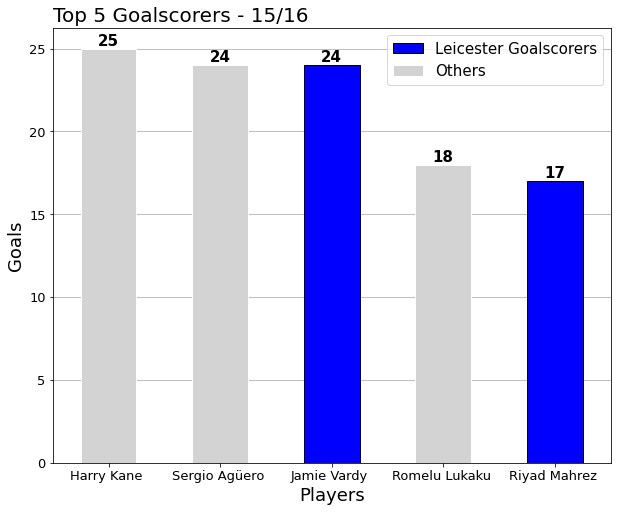

In [133]:
pl16 = pl16[pl16['Appearances']!=0]
goalscorers = pl16.nlargest(5, ['Goals']).reset_index()

from matplotlib.patches import Patch
custom_lines = [ Patch(facecolor='Blue', edgecolor='black',label='Leicester Goalscorers'),
                Patch(facecolor='lightgrey', edgecolor='white',label='Others')]




color = ["blue" if i==2 or i==4 else "lightgrey" for i in goalscorers.index]
edgecolor= ["black" if i==2 or i==4 else "white" for i in goalscorers.index]
#goalscorers.iplot(kind='bar',x='Name',y='Goals',title='Top Goalscorers - 15/16', xTitle='Players', yTitle='Goals',color='red')
ax = goalscorers.plot.bar(x="Name",y = "Goals", color= color,figsize =(10,8),edgecolor= edgecolor,legend = None)
plt.xticks(rotation = 0,fontsize = 13)
plt.yticks(fontsize = 13)
plt.xlabel("Players",fontsize = 18)
plt.ylabel("Goals",fontsize = 18)
plt.title("Top 5 Goalscorers - 15/16",fontsize = 20,loc='left')
ax.yaxis.grid(zorder = 0)
ax.set_axisbelow(True)

for x,y,z in zip(goalscorers.index, goalscorers["Goals"], goalscorers["Goals"]):
    plt.text(x, y, z,verticalalignment='bottom',horizontalalignment='center',fontsize = 15,weight='bold')

ax.legend(custom_lines, ['Leicester Goalscorers', 'Others'],fontsize = 15)

plt.show()

### top 5 Playmakers

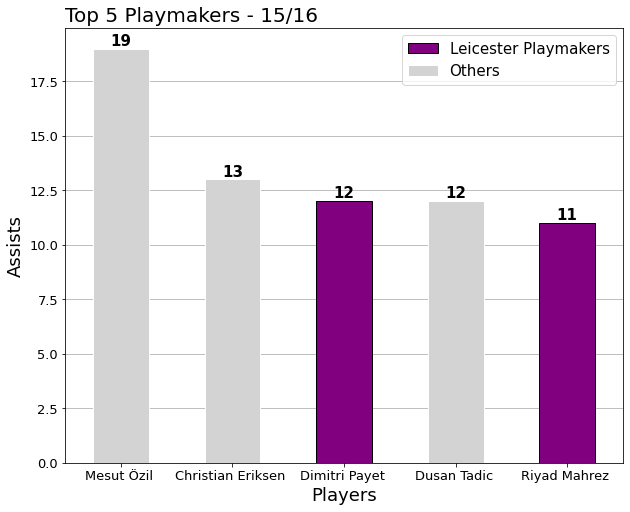

In [134]:
playmakers = pl16.nlargest(5, ['Assists']).reset_index()

color = ["purple" if i==2 or i==4 else "lightgrey" for i in playmakers.index]
edgecolor= ["black" if i==2 or i==4 else "white" for i in playmakers.index]

from matplotlib.patches import Patch
custom_lines = [ Patch(facecolor='purple', edgecolor='black',label='Leicester Goalscorers'),
                Patch(facecolor='lightgrey', edgecolor='white',label='Others')]


#goalscorers.iplot(kind='bar',x='Name',y='Goals',title='Top Goalscorers - 15/16', xTitle='Players', yTitle='Goals',color='red')
ax = playmakers.plot.bar(x="Name",y = "Assists", color= color,figsize =(10,8),edgecolor= edgecolor,legend = None)
plt.xticks(rotation = 0,fontsize = 13)
plt.yticks(fontsize = 13)
plt.xlabel("Players",fontsize = 18)
plt.ylabel("Assists",fontsize = 18)
plt.title("Top 5 Playmakers - 15/16",fontsize = 20,loc='left')
ax.yaxis.grid(zorder = 0)
ax.set_axisbelow(True)


ax.legend(custom_lines, ['Leicester Playmakers', 'Others'],fontsize = 15)



for x,y,z in zip(playmakers.index, playmakers["Assists"], playmakers["Assists"]):
    plt.text(x, y, z,verticalalignment='bottom',horizontalalignment='center',fontsize = 15,weight='bold')

plt.show()

In [378]:
#Creating a new column 'Involvements'

pl16['Involvements'] = pl16['Goals'] + pl16['Assists']
pl16[['Name','Involvements']].head()


,Name,Involvements
0,Rolando Aarons,2
1,Almen Abdi,2
2,Abdul Rahman Baba,1
3,Mehdi Abeid,0
4,Tammy Abraham,0


### Most Involvements

In [379]:
from matplotlib.lines import Line2D

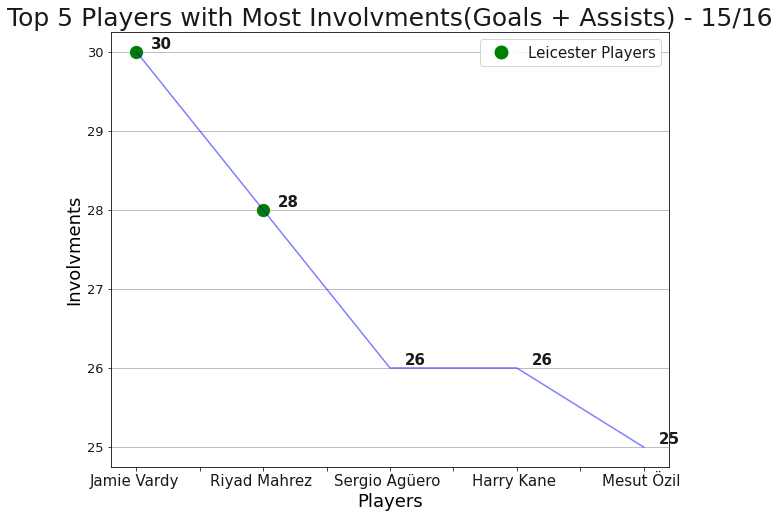

In [380]:
involvements = pl16.nlargest(5, 'Involvements')
inv = involvements.reset_index().drop('index',axis=1)

ax = inv.plot(x='Name',y='Involvements',figsize=(10,8),color ='blue',alpha= 0.5)

plt.xticks(fontsize = 15)
plt.yticks(fontsize = 13)
plt.xlabel("Players",fontsize = 18)
plt.ylabel("Involvments",fontsize = 18)
plt.title("Top 5 Players with Most Involvments(Goals + Assists) - 15/16",fontsize = 25)

ax=plt.gca()
ax.yaxis.grid(zorder = 0)
ax.set_axisbelow(True)



legend_elements = [Line2D([0], [0], marker='o', color='w', label='Scatter',markerfacecolor='g', markersize=15)]
ax.legend(legend_elements, ['Leicester Players'],fontsize = 15)

for x,y,z in zip(inv.index, inv["Involvements"], inv["Involvements"]):
    plt.text(x+0.2, y, z,verticalalignment='bottom',horizontalalignment='center',fontsize = 15,weight='bold')
    if x == 0 or x == 1:
        plt.scatter(x,y,c="green",s= 150)


### goals conceded by defenders per game

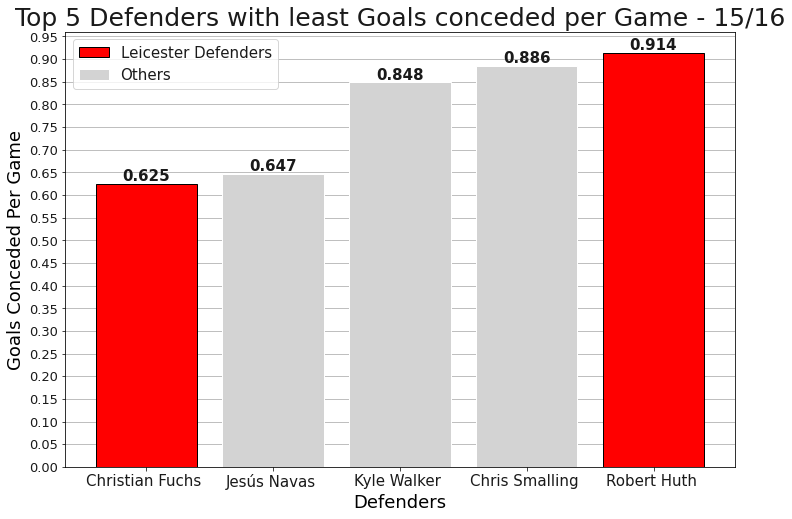

In [381]:
#Making a dataframe with only defenders
defenders = pl16[pl16['Position']=='Defender']
plt.figure(figsize = (12,8))
#Selecting defenders with more than 30 appearances and making a new column 'Conceded per game',
#which is Goals conceded/Appearances.


from matplotlib.patches import Patch
custom_lines = [ Patch(facecolor='red', edgecolor='black'),
                Patch(facecolor='lightgrey', edgecolor='white')]

top_def_stats = defenders[defenders['Appearances']>30]

top_def_stats['Conceded per game'] = top_def_stats['Goals conceded']/top_def_stats['Appearances']
least_conceded = top_def_stats.nsmallest(5, 'Conceded per game')
a_data = least_conceded.reset_index().drop("index",axis=1)
color = ["red","lightgrey","lightgrey","lightgrey","red"]
edgecolor= ["black" if i==0 or i==4 else "white" for i in a_data.index]
ax1 = plt.bar(a_data["Name"],a_data["Conceded per game"],color = color,edgecolor=edgecolor)

plt.xticks(fontsize = 15)
plt.yticks(np.arange(0,1,0.05),fontsize = 13)


plt.xlabel("Defenders",fontsize = 18)
plt.ylabel("Goals Conceded Per Game",fontsize = 18)
plt.title("Top 5 Defenders with least Goals conceded per Game - 15/16",fontsize = 25)



ax=plt.gca()
ax.yaxis.grid(zorder = 0)
ax.set_axisbelow(True)

ax.legend(custom_lines, ['Leicester Defenders', 'Others'],fontsize = 15,loc='best')

for x,y,z in zip(a_data.index, a_data["Conceded per game"], a_data["Conceded per game"]):
    plt.text(x, y, round(z,3),verticalalignment='bottom',horizontalalignment='center',fontsize = 15,weight='bold')

plt.show()

### top 5 goalkeepers in the 2015/16 season
#### Leicester keeper highlighted in yellow (Kasper Schmeichel)

In [382]:
gks.style.apply(lambda x:['background:yellow'
                             if (x.name=="Kasper Schmeichel ")
                             else '' for i in x], axis=1)

,Appearances,Clean sheets,Goals conceded,Saves
Name,,,,
Lukasz Fabianski,37,9.000000,51.000000,115.000000
Heurelho Gomes,38,11.000000,49.000000,121.000000
Hugo Lloris,37,13.000000,34.000000,88.000000
Kasper Schmeichel,38,15.000000,36.000000,99.000000


### Regression model to predict the position of teams in the premier league- based on goal differential

In [146]:
import numpy as np
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
import pandas as pd

In [147]:
reg_data=data[["Club","Position","Played","Won","Drawn","Lost","GF","GA","GD","Points","season"]]

reg_data.loc[:,'year']=1993


for j in range(1,len(df_season)):
    if j==14:
        df_add =pd.read_csv(df_season.loc[j,'loc'])
        df_add.rename(columns={'PointsForm':'Points',}, inplace=True)
        df_add.rename(columns={'\tPlayed':'Played'}, inplace=True)
        df_add.loc[:,'year']=(1993+j)
        conc=df_add[["Club","Position","Played","Won","Drawn","Lost","GF","GA","GD","Points","season","year"]]
        reg_data=pd.concat([reg_data,conc])        
    
    elif j!=14:
        df_add =pd.read_csv(df_season.loc[j,'loc'])
        df_add.loc[:,'year']=(1993+j)
        df_add.rename(columns={'\tPlayed':'Played'}, inplace=True)
        conc=df_add[["Club","Position","Played","Won","Drawn","Lost","GF","GA","GD","Points","season","year"]]
        reg_data=pd.concat([reg_data,conc])

reg_data

,Club,Position,Played,Won,Drawn,Lost,GF,GA,GD,Points,season,year
0,Manchester United,1,42,24,12,6,67,31,36,84.0,1992/1993,1993
1,Aston Villa,2,42,21,11,10,57,40,17,74.0,1992/1993,1993
2,Norwich City,3,42,21,9,12,61,65,-4,72.0,1992/1993,1993
3,Blackburn Rovers,4,42,20,11,11,68,46,22,71.0,1992/1993,1993
4,Queens Park Rangers,5,42,17,12,13,63,55,8,63.0,1992/1993,1993
...,...,...,...,...,...,...,...,...,...,...,...,...
15,West Ham United,16,29,7,6,16,35,50,-15,27.0,2019/2020,2020
16,Watford,17,29,6,9,14,27,44,-17,27.0,2019/2020,2020
17,Bournemouth,18,29,7,6,16,29,47,-18,27.0,2019/2020,2020
18,Aston Villa,19,28,7,4,17,34,56,-22,25.0,2019/2020,2020


In [321]:
reg_data[reg_data['year']==2018]

,Club,Position,Played,Won,Drawn,Lost,GF,GA,GD,Points,season,year
0,Manchester City,1,38,32,4,2,106,27,79,100.0,2017/2018,2018
1,Manchester United,2,38,25,6,7,68,28,40,81.0,2017/2018,2018
2,Tottenham Hotspur,3,38,23,8,7,74,36,38,77.0,2017/2018,2018
3,Liverpool,4,38,21,12,5,84,38,46,75.0,2017/2018,2018
4,Chelsea,5,38,21,7,10,62,38,24,70.0,2017/2018,2018
5,Arsenal,6,38,19,6,13,74,51,23,63.0,2017/2018,2018
6,Burnley,7,38,14,12,12,36,39,-3,54.0,2017/2018,2018
7,Everton,8,38,13,10,15,44,58,-14,49.0,2017/2018,2018
8,Leicester City,9,38,12,11,15,56,60,-4,47.0,2017/2018,2018
9,Newcastle United,10,38,12,8,18,39,47,-8,44.0,2017/2018,2018


### top team has the highest GD while bottom team has the lowest
#### this may not be true in all cases as the Goal differences may minutely vary

In [320]:
data_2008 = reg_data[reg_data['year']==2008]
data_2008_copy =  data_2008 

data_2008.style.apply(lambda x:['background:yellowgreen'
                             if (x["Position"]==1)
                             else 'background:red'
                             if (x["Position"]==20) 
                             else '' for i in x], axis=1)



,Club,Position,Played,Won,Drawn,Lost,GF,GA,GD,Points,season,year
0,Manchester United,1,38,27,6,5,80,22,58,87.000000,2007/2008,2008
1,Chelsea,2,38,25,10,3,65,26,39,85.000000,2007/2008,2008
2,Arsenal,3,38,24,11,3,74,31,43,83.000000,2007/2008,2008
3,Liverpool,4,38,21,13,4,67,28,39,76.000000,2007/2008,2008
4,Everton,5,38,19,8,11,55,33,22,65.000000,2007/2008,2008
5,Aston Villa,6,38,16,12,10,71,51,20,60.000000,2007/2008,2008
6,Blackburn Rovers,7,38,15,13,10,50,48,2,58.000000,2007/2008,2008
7,Portsmouth,8,38,16,9,13,48,40,8,57.000000,2007/2008,2008
8,Manchester City,9,38,15,10,13,45,53,-8,55.000000,2007/2008,2008
9,West Ham United,10,38,13,10,15,42,50,-8,49.000000,2007/2008,2008


In [285]:
pd.DataFrame(data_2008.iloc[0,:])

,0
Club,Manchester United
Position,1
Played,38
Won,27
Drawn,6
Lost,5
GF,80
GA,22
GD,58
Points,87.0


In [164]:
x = reg_data["GD"].values.reshape(-1,1)
y = reg_data["Position"].values

In [165]:
model= LinearRegression()
model.fit(x,y)
evaluation_score = model.score(x,y)
intercept = model.intercept_
slope = model.coef_

In [166]:
print("score",evaluation_score)

score 0.7644324848047668


In [195]:
y_pred = intercept + slope*x

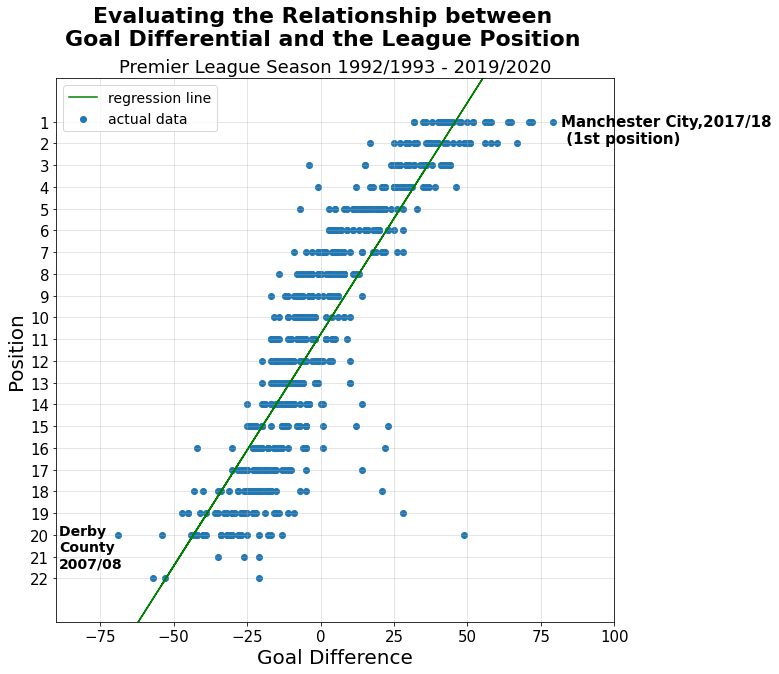

In [331]:
fig,ax = plt.subplots(figsize=(10,10))
plt.scatter(x,y,label="actual data")
plt.ylim(-1,24)
plt.xlim(-90,100)
plt.gca().invert_yaxis()
ax.grid(alpha=0.4)
plt.plot(x,y_pred,c="g",label = 'regression line')
plt.xlabel("Goal Difference",fontsize = 20)
plt.ylabel("Position",fontsize = 20)
plt.xticks(fontsize = 15)
plt.yticks(np.arange(1,23,1),fontsize = 15)
ax.annotate(xy=(82,2),text='Manchester City,2017/18\n (1st position)',fontsize = 15,fontweight="bold")
ax.annotate(xy=(-89,21.5),text='Derby \nCounty\n2007/08',fontweight="bold",fontsize = 14)
#plt.title("Evaluating the Relationship between Goal Differential and the League Position in the Points Table \nPremier league 1992/1993 - 2019/2020")
plt.suptitle("Evaluating the Relationship between \nGoal Differential and the League Position \n",ha='center',fontsize=22,fontweight="bold")
plt.title('Premier League Season 1992/1993 - 2019/2020',fontsize=18)
plt.legend(fontsize=14)
plt.show()

In [385]:
df_2021 = pd.DataFrame(columns= ["Club","Goal Diff","Real-time position"])

#### getting real time data from the ongoing premier league season -2021/22

In [386]:
x_final = np.array([13,55,8,38,50,11,10,5,-9,-4,1,-17,-10,1,-18,-14,-26,-45,-33])
y_final = np.array([4,2,6,3,1,5,7,8,11,10,9,14,13,12,17,15,18,20,16])


df_2021["Club"] = ["Arsenal","Liverpool","Manchester United","Chelsea","Manchester City","Tottenham Hotspur","West Ham",
                   "Wolves","Southampton","Leicester City","Aston Villa","Newcastle","Brighton","Crystal Palace",
                  "Everton","Brentford","Watford","Norwich City","Leeds United"]
df_2021["Goal Diff"] = x_final
df_2021["Real-time position"] = y_final

#["Manchester City","Liverpool","Chelsea","Arsenal","Tottenham Hotspur","Manchester United]
#[50,55,38,13,11,8]
#[1,2,3,4,5,6]
 
#["Arsenal","Liverpool","Manchester United","Chelsea","Manchester City","Tottenham Hotspur"]
#[13,55,8,38,50,11]
#[4,2,6,3,1,5]

df_2021


,Club,Goal Diff,Real-time position
0,Arsenal,13,4
1,Liverpool,55,2
2,Manchester United,8,6
3,Chelsea,38,3
4,Manchester City,50,1
5,Tottenham Hotspur,11,5
6,West Ham,10,7
7,Wolves,5,8
8,Southampton,-9,11
9,Leicester City,-4,10


In [387]:
x_final = x_final.reshape(-1,1)
print("Goal_diff shape",x_final.shape)

Goal_diff shape (19, 1)


In [388]:
y_pred_final = model.predict(x_final)
y_pred_final

array([ 8.00947836, -0.94151534,  9.07507285,  2.68150592,  0.12407915,
        8.43571616,  8.64883505,  9.71442954, 12.69809411, 11.63249962,
       10.56690513, 14.40304529, 12.91121301, 10.56690513, 14.61616419,
       13.7636886 , 16.32111537, 20.37037443, 17.81294765])

In [389]:
print("real time results",y_final)

print("predicted league standings based on goal diff",y_pred_final)

real time results [ 4  2  6  3  1  5  7  8 11 10  9 14 13 12 17 15 18 20 16]
predicted league standings based on goal diff [ 8.00947836 -0.94151534  9.07507285  2.68150592  0.12407915  8.43571616
  8.64883505  9.71442954 12.69809411 11.63249962 10.56690513 14.40304529
 12.91121301 10.56690513 14.61616419 13.7636886  16.32111537 20.37037443
 17.81294765]


In [390]:
df_2021["predicted position"] = y_pred_final

In [391]:
df_2021.head()

,Club,Goal Diff,Real-time position,predicted position
0,Arsenal,13,4,8.009478
1,Liverpool,55,2,-0.941515
2,Manchester United,8,6,9.075073
3,Chelsea,38,3,2.681506
4,Manchester City,50,1,0.124079


In [392]:
df_plot2 = df_2021.sort_values("Real-time position")
df_plot2.set_index("Club",inplace=True)

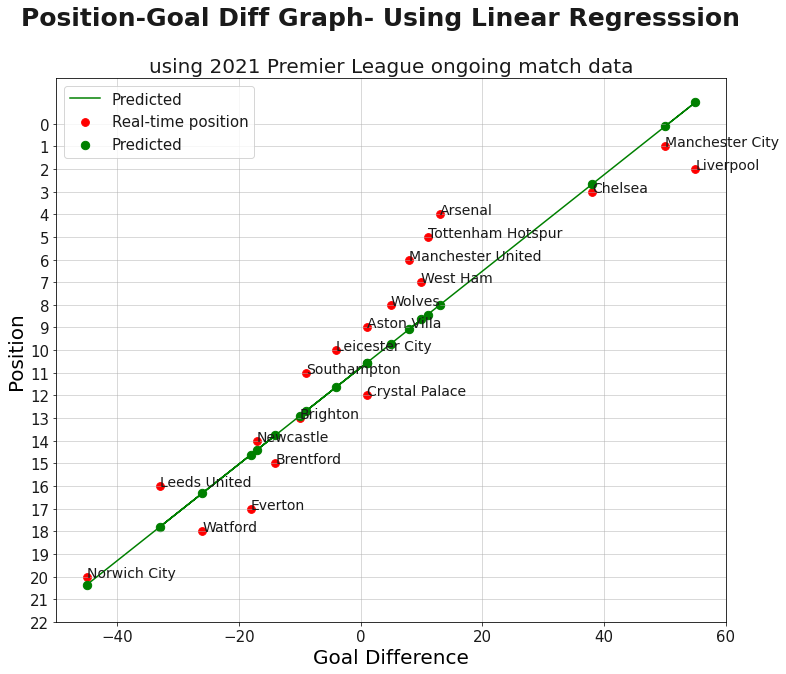

In [393]:

fig, ax = plt.subplots(figsize = (12,10))
df_plot2.plot.scatter('Goal Diff',"Real-time position",color = "red",ax=ax,label = "Real-time position",s=60)

df_plot2.plot("Goal Diff","predicted position",color= "green",label = "Predicted",ax=ax)
df_plot2.plot.scatter("Goal Diff","predicted position",color= "green",label = "Predicted",ax=ax,s=70)
for k, v in df_plot2[["Goal Diff","Real-time position"]].iterrows():
    ax.annotate(k, v,fontsize=14)

plt.xlabel("Goal Difference",fontsize = 20)
plt.ylabel("Position",fontsize = 20)
plt.xticks(fontsize = 15)
plt.yticks(np.arange(0,23,1),fontsize = 15)
plt.grid(alpha=0.6)
plt.legend(fontsize = 15)
plt.suptitle("Position-Goal Diff Graph- Using Linear Regresssion",fontsize = 25,fontweight='bold')
plt.title("using 2021 Premier League ongoing match data",fontsize=20)
plt.gca().invert_yaxis()
plt.show()


### trying to get more accurate values using Polynomial Regression 

In [222]:
from sklearn.preprocessing import PolynomialFeatures
x = reg_data["GD"].values.reshape(-1,1)
y = reg_data["Position"].values
poly_reg = PolynomialFeatures(degree=5)
X_poly = poly_reg.fit_transform(x)
pol_reg = LinearRegression()
pol_reg.fit(X_poly, y)

LinearRegression()

In [223]:
x_final.shape

(19, 1)

In [224]:
# Predicting a new result with Polymonial Regression
poly_pred = pol_reg.predict(poly_reg.fit_transform(x_final))
#output should be 132148.43750003

In [225]:
poly_pred

array([ 6.71401724,  2.04130727,  7.90964258,  2.88033697,  2.21013981,
        7.17737508,  7.41665674,  8.68255368, 12.65662408, 11.18985023,
        9.76724592, 15.00394228, 12.95217198,  9.76724592, 15.29068115,
       14.13149776, 17.46068925, 20.83656775, 19.07596029])

In [226]:
df_2021["predicted position"] = poly_pred

In [227]:
df_2021

,Club,Goal Diff,Real-time position,predicted position
0,Arsenal,13,4,6.714017
1,Liverpool,55,2,2.041307
2,Manchester United,8,6,7.909643
3,Chelsea,38,3,2.880337
4,Manchester City,50,1,2.210140
5,Tottenham Hotspur,11,5,7.177375
6,West Ham,10,7,7.416657
7,Wolves,5,8,8.682554
8,Southampton,-9,11,12.656624
9,Leicester City,-4,10,11.189850


In [228]:
df_plot1 = df_2021.sort_values("Real-time position")

In [229]:
df_plot1.set_index("Club",inplace = True)

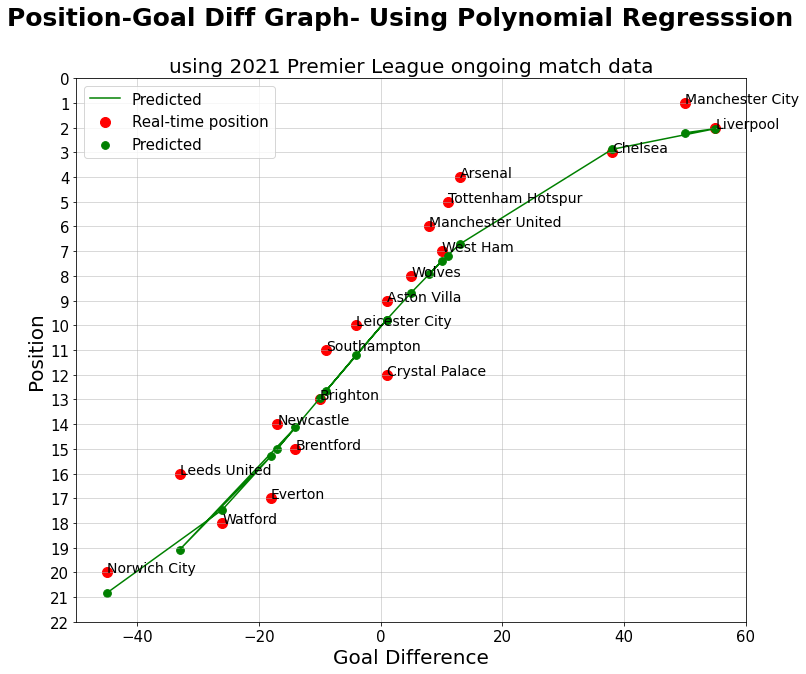

In [338]:

fig, ax = plt.subplots(figsize = (12,10))
df_plot1.plot.scatter('Goal Diff',"Real-time position",color = "red",ax=ax,label = "Real-time position",s=100)

df_plot1.plot("Goal Diff","predicted position",color= "green",label = "Predicted",ax=ax)
df_plot1.plot.scatter("Goal Diff","predicted position",color= "green",label = "Predicted",ax=ax,s=60)
for k, v in df_plot1[["Goal Diff","Real-time position"]].iterrows():
    ax.annotate(k, v,fontsize = 14)

plt.xlabel("Goal Difference",fontsize = 20)
plt.ylabel("Position",fontsize = 20)
plt.xticks(fontsize = 15)
plt.yticks(np.arange(0,23,1),fontsize = 15)
plt.grid(alpha=0.6)


plt.legend(fontsize = 15)

plt.suptitle("Position-Goal Diff Graph- Using Polynomial Regresssion",fontsize = 25,fontweight='bold')
plt.title("using 2021 Premier League ongoing match data",fontsize=20)

plt.gca().invert_yaxis()
plt.show()


In [394]:
file_name = 'poly_reg_data.csv'
  
# saving the excel
df_plot1.to_csv(file_name)


In [395]:
file_name = 'linear_reg_data.csv'
  
# saving the excel
df_plot2.to_csv(file_name)